# **Lab 3: Reconstruction from two views (knowing internal camera parameters)**

In this lab you will learn how to estimate the fundamental matrix that relates two images, corresponding to two different views of the same scene, given a set of correspondences between them. Also, you will learn how to triangulate the matching correspondences between two views of the same scene, by means of applying the Direct Linear Method (DLT). Then, you will compute the camera matrices of these images given the Fundamental Matrix and the Intrinsic Matrix, and will evaluate your triangulation method on these camera matrices by estimating the reprojection error in the triangulation. 

The following file combines some text cells (Markdown cells) and code cells. Some parts of the code need to be completed. All tasks you need to complete are marked in <span style='color:Green'> green.  </span>

In [1]:
from IPython.display import display, HTML
import numpy as np
from numpy import linalg as LA
import cv2
import math
import sys
import random
import matplotlib
from matplotlib import pyplot as plt
matplotlib.rcParams['figure.figsize'] = (19, 10)
from operator import itemgetter
from plotly import graph_objects as go
import copy
from tqdm import tqdm
from multiprocessing import Pool
import numpy as np
from time import time 
from functools import partial

import utils
from utils import homogeneous2euclidean, euclidean2homogeneous, projective2img, img2projective

np.set_printoptions(precision=3)

## **1. Estimation of the fundamental matrix**

### **1.1 Normalized 8-point algorithm**

The first task is to create the function that estimates the fundamental matrix given a set of point correspondences between a pair of images.

<span style='color:Green'> - Complete the function "fundamental_matrix" below.  </span>

In [2]:
def normalize_p(p):
    
    num_p = p.shape[1]
    
    p[:, :] /= p[2, :]
    
    # centroid
    centroid = []
    centroid_x = np.mean(p[0, :]) # x
    centroid_y = np.mean(p[1, :]) # y
    
    # mean distance to origin
    origin_x = np.empty(num_p)
    origin_x = p[0, :] - centroid_x
    
    origin_y = np.empty(num_p)
    origin_y = p[1, :] - centroid_y
    d = np.sqrt(origin_x[:]**2 + origin_y[:]**2)
    d_mean = np.mean(d)
    
    # scaling
    s = np.sqrt(2)/d_mean
    
    # translation
    t = [-s*centroid_x, -s*centroid_y]
    H = np.array([[s, 0, t[0]],
                  [0, s, t[1]],
                  [0, 0,   1]])
    
    p_norm = H @ p
    
    return p_norm, H
    
    
def fundamental_matrix(points1, points2, check_n=False):
    
    # point normalization
    #p1n = points1[:, :]/points1[2, :]
    #p2n = points2[:, :]/points2[2, :]
    p1n, H1 = normalize_p(points1)
    p2n, H2 = normalize_p(points2)
    
    if check_n:
        # check of normalizations
        print('The normalized centroid of points1 is located at:')
        print([f'{np.mean(p1n[0, :]):.5f}', f'{np.mean(p1n[1, :]):.5f}'])

        print('\nThe mean squared distance between normalized points1 and origin is:')
        print(f'{(np.mean(np.sqrt(p1n[0, :]**2 + p1n[1, :]**2))**2):.5f} \n\n')

        print('The normalized centroid of points2 is located at:')
        print([f'{np.mean(p2n[0, :]):.5f}', f'{np.mean(p2n[1, :]):.5f}'])

        print('\nThe mean squared distance between normalized points2 and origin is:')
        print(f'{(np.mean(np.sqrt(p2n[0, :]**2 + p2n[1, :]**2))**2):.5f} \n\n')
    
    _, n_points = points1.shape
    
    # W
    W = np.ones((n_points, 9)) # W is of size nx9
    W[:, 0] = p1n[0, :]*p2n[0, :]
    W[:, 1] = p1n[1, :]*p2n[0, :]
    W[:, 2] =           p2n[0, :]
    W[:, 3] = p1n[0, :]*p2n[1, :]
    W[:, 4] = p1n[1, :]*p2n[1, :]
    W[:, 5] =           p2n[1, :]
    W[:, 6] = p1n[0, :]
    W[:, 7] = p1n[1, :]
    #W[:, 8] = 1
    
    U, D, Vt = LA.svd(W)
    
    F_r3 = np.reshape(Vt[-1, :], (3, 3))
    
    # force F to have rank 2
    U_F, D_F, Vt_F = LA.svd(F_r3)
    
    D_new = [[D_F[0],      0, 0],
             [0     , D_F[1], 0],
             [0     ,      0, 0]]
    
    F_n = U_F @ D_new @ Vt_F
    
    # denormalize F
    F = H2.T @ F_n @ H1
    
    return F

In order to check that the completed function works properly you may use this code which is a toy example where we know the ground truth image.

<span style='color:Green'> - Complete the expression of the ground truth fundamental matrix.  </span>

In [3]:
def cross_matrix(vector):
    return np.array([[0, -vector[0, 2], vector[0, 1]],
                     [vector[0, 2], 0, -vector[0, 0]],
                     [-vector[0, 1], vector[0, 0], 0]])

# Two camera matrices for testing purposes
P1 = np.zeros((3,4))
P1[0,0]=P1[1,1]=P1[2,2]=1
angle = 15
theta = np.radians(angle)
c = np.cos(theta)
s = np.sin(theta)
R = np.array([[c, -s, 0], [s, c, 0], [0, 0, 1]])
t = np.array([[.3, .1, .2]])

P2 = np.concatenate((R, t.T), axis=1)
n = 8
rand = np.random.uniform(0,1,n)
rand = rand.reshape((1, n))
rand2 = np.random.uniform(0,1,2*n)
rand2 = rand2.reshape((2, n))
ones = np.ones((1,n))
X = np.concatenate((rand2, 3*rand, ones), axis=0)

# WE SEE THAT P1 IS DEFINED AS THE INDENTITY MATRIX,
# AND SINCE WE USE IT AS REFERENCE, IT HAS NO ROTATION OR TRANSLATION,
# SO K1=P1=I_3. AND, WE KNOW THAT K2=I_3 SINCE WE SUPPOSE THAT BOTH 
# CAMERAS HAVE THE SAME INTRINSIC PARAMETERS, AND ALSO BECAUSE 
# P2=K2[R|t], AND SINCE WE HAVE IN THE CODE "P2 = np.concatenate((R, t.T), axis=1)"
# THEN WE KNOW THAT K2=I_3
K1 = K2 = np.eye(3)

x1_test = P1 @ X
x2_test = P2 @ X

# Estimate fundamental matrix (you need to create this function)
F_es = fundamental_matrix(x1_test, x2_test, check_n=True)

# Ground truth fundamental matrix 
# SINCE K1 AND K2 ARE IDENTITY, WE DON'T NEED TO PUT THEM
# BUT WE HAVE PUT THEM TO SHOW HOW THE REAL EQUATION IS
F_gt = LA.inv(K2).T @ cross_matrix(t) @ R @ LA.inv(K1)


# Evaluation: these two matrices should be very similar
F_gt = np.sign(F_gt[0,0])*F_gt / LA.norm(F_gt)
F_es = np.sign(F_es[0,0])*F_es / LA.norm(F_es)
print("F_gt:\n", F_gt)
print("F_es:\n", F_es)
print(LA.norm(F_gt-F_es))

The normalized centroid of points1 is located at:
['0.00000', '0.00000']

The mean squared distance between normalized points1 and origin is:
2.00000 


The normalized centroid of points2 is located at:
['-0.00000', '-0.00000']

The mean squared distance between normalized points2 and origin is:
2.00000 


F_gt:
 [[ 0.098  0.365 -0.189]
 [-0.365  0.098  0.567]
 [ 0.036 -0.597 -0.   ]]
F_es:
 [[ 9.782e-02  3.651e-01 -1.890e-01]
 [-3.651e-01  9.782e-02  5.669e-01]
 [ 3.581e-02 -5.965e-01  2.101e-15]]
8.935136342481092e-14


### **1.2 Robust estimation of the fundamental matrix**

The goal of this section is to estimate the fundamental matrix in a practical situation where the image correspondences contain outliers. For that you will have to write the code of the robust version of the previous algorithm.

We will start by computing and visualizing the image matches.

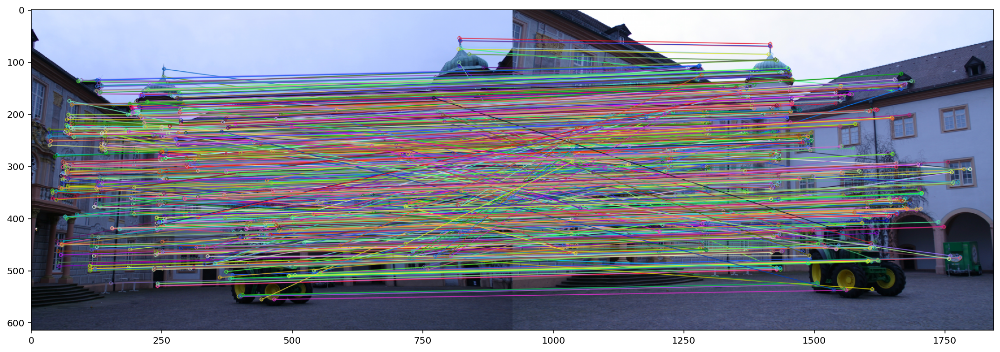

In [78]:
# Compute inage correspondences #

# Read images
img1c = cv2.imread('Data/0000_s.png')
img2c = cv2.imread('Data/0001_s.png')
img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB) 
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB) 

img1 = cv2.cvtColor(img1c, cv2.COLOR_RGB2GRAY)
img2 = cv2.cvtColor(img2c, cv2.COLOR_RGB2GRAY)

# Initiate ORB detector
orb = cv2.ORB_create(3000)
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

# Keypoint matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)

# Show "good" matches
img_12 = cv2.drawMatches(img1c,kp1,img2c,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

<span style='color:Green'> - Write the function Ransac_fundamental_matrix that embeds in a RANSAC procedure the previous DLT algorithm for estimating the fundamental matrix. You may use the provided RANSAC function in lab 2 as a starting point.  </span>

Note: In order not to end up, eventually, in an infinite loop, it is recommended to set, at each iteration, the maximum number of iterarions to the maximum between a predefined maximum number of iterations by the user and the automatically estimated max. number of iterarions. The estimated number of iterations ensures we pick, with a probability of 0.99, an initial set of correspondences with no outliers.

In [4]:
def Inliers(F, x1, x2, th):

    x1_trans = F@x1
    x2_trans = F.T@x2
    
    x1_trans /= x1_trans[2, :]
    x2_trans /= x2_trans[2, :]
    
    # sampson distance:
    enum = np.diag(x2.T@F@x1)
    #enum = x2.T@F@x1
    denom = (x1_trans[0]**2 + x1_trans[1]**2 + x2_trans[0]**2 + x2_trans[1]**2)
    sampson = enum**2 / denom
    return np.where(np.array(sampson) < th)[0]

def Ransac_fundamental_matrix(points1, points2, th, max_it):
    
    Ncoords, Npts = points1.shape
    
    it = 0
    best_inliers = np.empty(1)
    
    max_it_pre = max_it
    while it < max_it:
        indices = random.sample(range(1, Npts), 8)
        F = fundamental_matrix(points1[:,indices], points2[:,indices])
        inliers = Inliers(F, points1, points2, th)
        
        # test if it is the best model so far
        if inliers.shape[0] > best_inliers.shape[0]:
            best_inliers = inliers
        
        # update estimate of iterations (the number of trials) to ensure we pick, with probability p,
        # an initial data set with no outliers
        fracinliers = inliers.shape[0]/Npts
        #print(f"> {inliers.shape[0]} - {Npts} - {fracinliers}")
        pNoOutliers = 1 -  fracinliers**8 # 8 points required
        eps = sys.float_info.epsilon
        pNoOutliers = max(eps, pNoOutliers)   # avoid division by -Inf
        pNoOutliers = min(1-eps, pNoOutliers) # avoid division by 0
        p = 0.99
        
        #max_it = math.log(1-p)/math.log(pNoOutliers)
        # WE MUST AVOID INFINITE LOOPS
        max_it = min(max_it_pre, int(math.log(1-p)/math.log(pNoOutliers))) # To avoid infinite loops

        it += 1
    
    # compute F from all the inliers
    F = fundamental_matrix(points1[:,best_inliers], points2[:,best_inliers])
    inliers = best_inliers
    
    return F, inliers

Obtained F:
[[ 1.570e-06 -5.777e-06 -1.384e-03]
 [ 3.220e-06  7.877e-07  4.813e-03]
 [ 1.742e-03 -3.275e-03  3.631e-01]]
Number of found matches by ORB: 1010
The number of inliers found by RANSAC is: 504


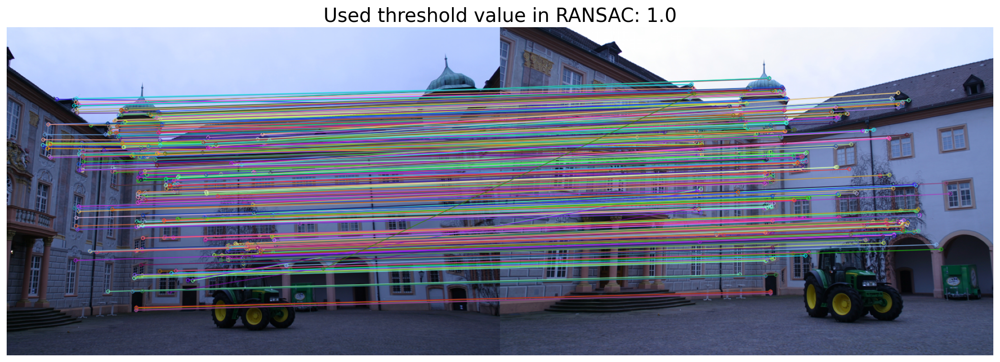

In [80]:
# Robust estimation of the fundamental matrix #
points1 = []
points2 = []
for m in matches:
    points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
    points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])
    
points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

th = 1.
F, indices_inlier_matches = Ransac_fundamental_matrix(points1, points2, th, 5000)
print("Obtained F:")
print(F)
inlier_matches = itemgetter(*indices_inlier_matches)(matches)
print('Number of found matches by ORB: '+ str(len(points1[0])))
print('The number of inliers found by RANSAC is: '+ str(len(inlier_matches)))

img_12 = cv2.drawMatches(img1c,kp1,img2c,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.title(f'Used threshold value in RANSAC: {th}', fontsize=20)
plt.axis('off')
plt.show()

### **1.3 Epipolar lines**

Now the fundamental matrix has been estimated we are going to display some points and their corresponding epipolar lines.

<span style='color:Green'> - Complete the code that computes the epipolar lines in both images.  </span>

(-0.5, 921.5, 613.5, -0.5)

<Figure size 1368x720 with 0 Axes>

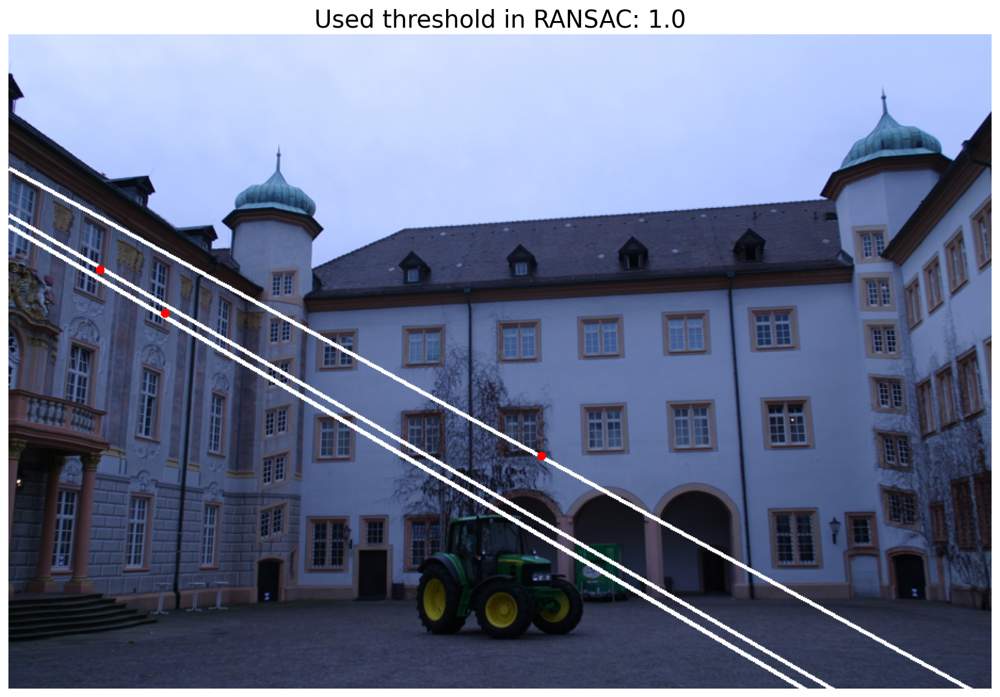

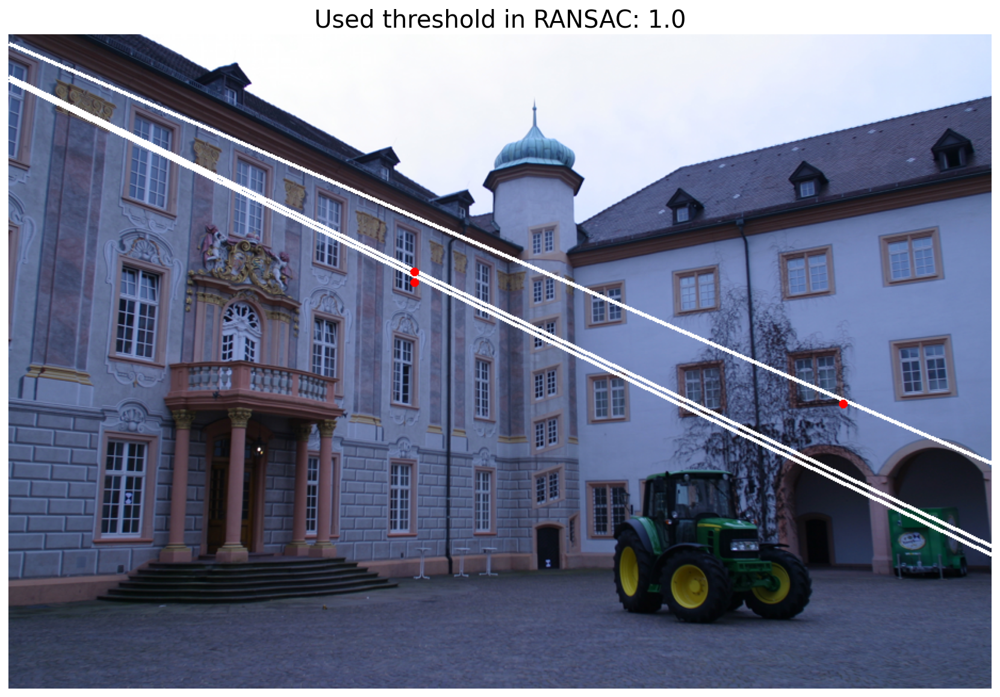

In [81]:
l2 = F @ points1 
l1 = F.T @ points2

# choose three random indices
N = indices_inlier_matches.shape[0]
indices = random.sample(range(1, N), 3)

m1 = indices_inlier_matches[indices[0]]
m2 = indices_inlier_matches[indices[1]]
m3 = indices_inlier_matches[indices[2]]

from PIL import Image, ImageDraw
from utils import line_draw, plot_img

img_path = "./Data/0000_s.png"
I = Image.open(img_path)
size = I.size
canv = ImageDraw.Draw(I)
line_draw(l1[:,m1], canv, size)
line_draw(l1[:,m2], canv, size)
line_draw(l1[:,m3], canv, size)
canv.ellipse((round(points1[0,m1]), round(points1[1,m1]), round(points1[0,m1])+7, round(points1[1,m1])+7), fill = 'red', outline ='red')
canv.ellipse((round(points1[0,m2]), round(points1[1,m2]), round(points1[0,m2])+7, round(points1[1,m2])+7), fill = 'red', outline ='red')
canv.ellipse((round(points1[0,m3]), round(points1[1,m3]), round(points1[0,m3])+7, round(points1[1,m3])+7), fill = 'red', outline ='red')
fig = matplotlib.pyplot.gcf()
plot_img(I)
plt.title(f'Used threshold in RANSAC: {th}', fontsize=20)
plt.axis('off')

img_path = "./Data/0001_s.png"
I2 = Image.open(img_path)
size = I2.size
canv2 = ImageDraw.Draw(I2)
line_draw(l2[:,m1], canv2, size)
line_draw(l2[:,m2], canv2, size)
line_draw(l2[:,m3], canv2, size)
canv2.ellipse((round(points2[0,m1]), round(points2[1,m1]), round(points2[0,m1])+7, round(points2[1,m1])+7), fill = 'red', outline ='red')
canv2.ellipse((round(points2[0,m2]), round(points2[1,m2]), round(points2[0,m2])+7, round(points2[1,m2])+7), fill = 'red', outline ='red')
canv2.ellipse((round(points2[0,m3]), round(points2[1,m3]), round(points2[0,m3])+7, round(points2[1,m3])+7), fill = 'red', outline ='red')
fig = matplotlib.pyplot.gcf()
plot_img(I2)
plt.title(f'Used threshold in RANSAC: {th}', fontsize=20)
plt.axis('off')


## **2. Triangulation with the DLT method**

The first task is to implement the DLT method that will compute the 3D points corresponding to the matches of two images whose camera matrices are known. [See derivation of DLT here](https://www.cs.cmu.edu/~16385/s17/Slides/11.4_Triangulation.pdf)

![image](https://user-images.githubusercontent.com/8356912/151347636-c3332917-a7da-402e-9eb6-f39beb91591a.png)


<span style='color:Green'> - Create the function triangulate(x1, x2, P1, P2, imsize) that performs a triangulation with the homogeneous algebraic method (DLT)  </span>

The entries are (x1, x2, P1, P2, imsize), where:
- x1: array of shape (3, `n_points`), containing matching points in projective coordinates from Camera 1 reference frame 
- x2: array of shape (3, `n_points`), containing matching points in projective coordinates from Camera 2 reference frame.
- P1: Camera 1 matrix of shape (3,4)
- P2: Camera 2 matrix of shape (3,4)
- imsize: Iterable with shape (2,) with the image size

The function should return:
- X: array of shape (4, `n_points`), containing the Homogenous Coordinates of the points in 3D space.  

Test the triangulate function: use this code to validate that the function triangulate works properly

HINT: check numpy.linalg.svd

In [5]:
# Write here the method for DLT triangulation
def triangulate(x1, x2, P1, P2, imsize) -> np.ndarray:
    assert P1.shape == (3,4) == P2.shape
    assert x1.shape == x2.shape and x1.shape[0] == 3
    
    # only one point
    if x1.ndim == 1:
        x1 = np.array([x1]).T
        x2 = np.array([x2]).T
    
    n_points = x1.shape[1]
    
    #x1=projective2img(x1)
    #x2=projective2img(x2)
    
    x1 = x1/x1[2,:]
    x2 = x2/x2[2,:]
    
    #Image shape
    nx=imsize[0]
    ny=imsize[1]
    
    #Normalization
    H = [[2/nx,0,-1],
         [0,2/ny,-1],
         [0,0,1]]
    
    x1_norm = H @ x1
    x2_norm = H @ x2
    P1_norm = H @ P1
    P2_norm = H @ P2
    
    X = np.empty(shape=(4,n_points))
    
    #Matrix A
    for i in range(n_points):
        
        A = np.array([x1_norm[0,i]*P1_norm[2,:]-P1_norm[0,:],
                      x1_norm[1,i]*P1_norm[2,:]-P1_norm[1,:],
                      x2_norm[0,i]*P2_norm[2,:]-P2_norm[0,:],
                      x2_norm[1,i]*P2_norm[2,:]-P2_norm[1,:]])
        
        U, S, Vh = LA.svd(A)
    
        X[:,i] = Vh[-1,:]
        
    return X

Test the triangulation function with two Cameras and some random points. The average triangulation error should be lower than 10<sup>-8</sup>


In [9]:
P1 = np.zeros((3,4))
P1[0,0]=P1[1,1]=P1[2,2]=1                            # Cam1 Canonical Camera Matrix

angle = 15
theta = np.radians(angle)
c = np.cos(theta)
s = np.sin(theta)
R = np.array([[c, -s, 0], [s, c, 0], [0, 0, 1]])     # Cam2 Rotation_z(theta[deg])
t = np.array([[1.1, .1, .2]])                         # Cam2 Translation(x[m], y[m], z[m]) 
P2 = np.concatenate((R, t.T), axis=1)

n_points = 20                                        # Number of data samples (points) (x,y,z)
X_eucl = np.random.uniform(0, 1, (3,n_points))       # Random points in 3D space on world reference frame
X_eucl[2,:] += 3                                     # Make points fit into the camera frame 
X = euclidean2homogeneous(X_eucl)                    # 

# Obtain the camera coordinates (rays) from each point.
x_proj1 = P1 @ X                                     # Project to Cam1 image coordinates (x,y,z)->[x_c1:y_c1:z_c1]
x_proj2 = P2 @ X                                     # Project to Cam2 image coordinates (x,y,z)->[x_c2:y_c2:z_c2]

# Estimate the 3D points (you need to create this function)
X_trian = triangulate(x_proj1, x_proj2, P1, P2, ((2,2)));
assert X_trian.shape == (4, n_points)

# Evaluation: compute the reprojection error
X_eucl_pred = homogeneous2euclidean(X_trian)
X_eucl = homogeneous2euclidean(X)
errors = np.linalg.norm(X_eucl - X_eucl_pred, axis=0)
avg_error = np.mean(errors)
print(f"Average triangulation error: {avg_error:.2e}[m]")
assert avg_error < 1e-8, "Something might be wrong here"


Average triangulation error: 1.87e-15[m]


 We will plot the results to check that the triangulated values are close to the ground truth

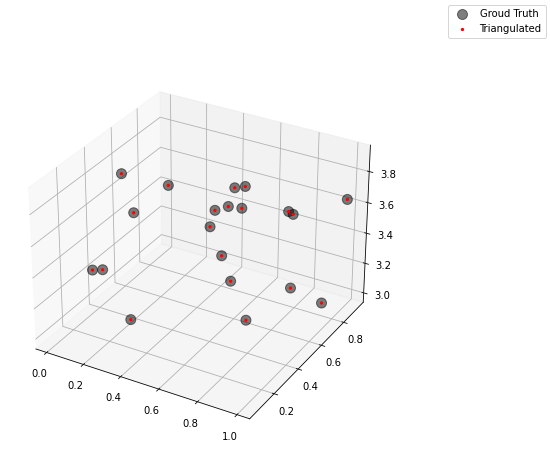

In [11]:
fig = plt.figure(figsize=(10,7))
ax = fig.add_subplot(projection='3d')
utils.draw_points(X_eucl.T, ax=ax, c="k", alpha=0.5, s=100, depthshade=True, label="Groud Truth")
utils.draw_points(X_eucl_pred.T, ax=ax, c="r", alpha=1, s=5, depthshade=True, label="Triangulated")
fig.legend()

In [12]:
fig = go.Figure(layout=dict(height=400, width=550))
fig.add_trace(go.Scatter3d(x=X_eucl[0,:], y=X_eucl[1,:], z=X_eucl[2,:], mode='markers', marker=dict(size=6, color="black", opacity=0.5), name='Ground Truth'))
fig.add_trace(go.Scatter3d(x=X_eucl_pred[0,:], y=X_eucl_pred[1,:], z=X_eucl_pred[2,:], mode='markers', marker=dict(size=2, color="red", opacity=1), name='Triangulated'))
fig.show()

## **3. Reconstruction from two views**

The goal of this section is to estimate the 3D reconstruction from two views in a practical situation where the image correspondences contain outliers. 

To acomplish this you have to:

1. Find a set of point correspondences between the two images. This correspondences will contain noise/outliers, therefore we cannot use [Epipolar Geometry](https://www.cs.cmu.edu/~16385/s17/Slides/12.1_Epipolar_Geometry.pdf) to calculate the [Essential Matrix](https://www.cs.cmu.edu/~16385/s17/Slides/12.2_Essential_Matrix.pdf), but we can find the Fundamental Matrix. 
2. Estimate the [Fundamental Matrix](https://www.cs.cmu.edu/~16385/s17/Slides/12.3_Fundamental_Matrix.pdf) relating the two camera images. Since correspondances are noisy we will use the [8-point Algorithm](https://www.cs.cmu.edu/~16385/s17/Slides/12.4_8Point_Algorithm.pdf) in combination with the RANSAC algorithm, to find a good estimate of $F$.
3. Calculate the Essential Matrix from the Fundamental Matrix
4. Find the two Camera Matrices.
### **3.1 Estimate the image matches**


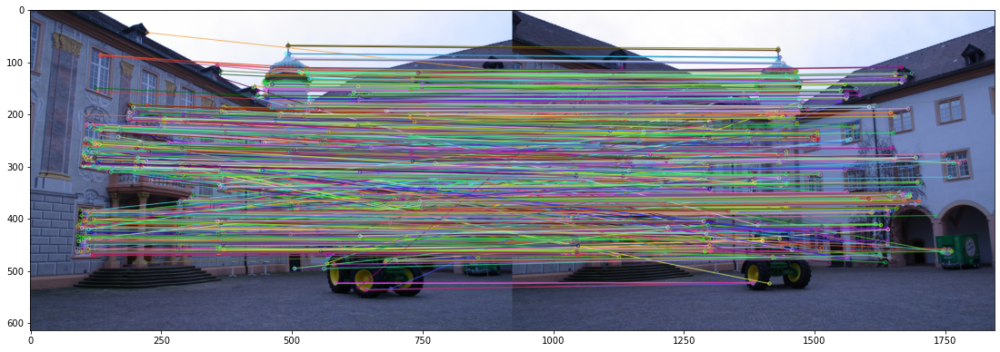

In [9]:
# Read images

img1c = cv2.imread('Data/0001_s.png')
img2c = cv2.imread('Data/0002_s.png')
img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB) 
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB) 

img1 = cv2.cvtColor(img1c, cv2.COLOR_RGB2GRAY)
img2 = cv2.cvtColor(img2c, cv2.COLOR_RGB2GRAY)


h, w = img1.shape

# Initiate ORB detector
orb = cv2.ORB_create(3000)
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

# Keypoint matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)

# Show "good" matches
img_12 = cv2.drawMatches(img1c,kp1,img2c,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
fig = plt.figure()
plt.imshow(img_12)
plt.show()

In [14]:
w, h

(922, 614)

In [10]:
matches

(< cv2.DMatch 00000269DB0605D0>,
 < cv2.DMatch 00000269CAD767B0>,
 < cv2.DMatch 00000269CAD76630>,
 < cv2.DMatch 00000269E319D770>,
 < cv2.DMatch 00000269E319D990>,
 < cv2.DMatch 00000269E319D310>,
 < cv2.DMatch 00000269E319D250>,
 < cv2.DMatch 00000269E319DA50>,
 < cv2.DMatch 00000269E319D1D0>,
 < cv2.DMatch 00000269E319D630>,
 < cv2.DMatch 00000269E319D810>,
 < cv2.DMatch 00000269E319D8D0>,
 < cv2.DMatch 00000269E319D9B0>,
 < cv2.DMatch 00000269E319D690>,
 < cv2.DMatch 00000269E319D830>,
 < cv2.DMatch 00000269E319D2B0>,
 < cv2.DMatch 00000269E319DBD0>,
 < cv2.DMatch 00000269E319DEF0>,
 < cv2.DMatch 00000269E319DA30>,
 < cv2.DMatch 00000269E319DA70>,
 < cv2.DMatch 00000269E319D230>,
 < cv2.DMatch 00000269E319D2D0>,
 < cv2.DMatch 00000269E319D870>,
 < cv2.DMatch 00000269E319D210>,
 < cv2.DMatch 00000269E319D7F0>,
 < cv2.DMatch 00000269E319D330>,
 < cv2.DMatch 00000269E319DAD0>,
 < cv2.DMatch 00000269E319D750>,
 < cv2.DMatch 00000269E319D290>,
 < cv2.DMatch 00000269E319D6D0>,
 < cv2.DMa

### **3.2 Estimate the Fundamental Matrix**
To find the Fundamental Matrix $F$ we will use the 8-point algorithm. However, using only 8 correspondences might lead to bad estimates of $F$. To find a robust estimate we will use the RANSAC algorithm. In simple words the algorithm samples randomly 8 correspondences and estimates $F_{estimated}$ for these samples, then it evaluates how well does $F_{estimated}$ fit the rest of the data. We repeat this process until a limit of iterations is reached and select the best estimated $F$.  

(Code is provided)

Number of found matches by ORB: 1324
The number of inliers found by RANSAC is: 775


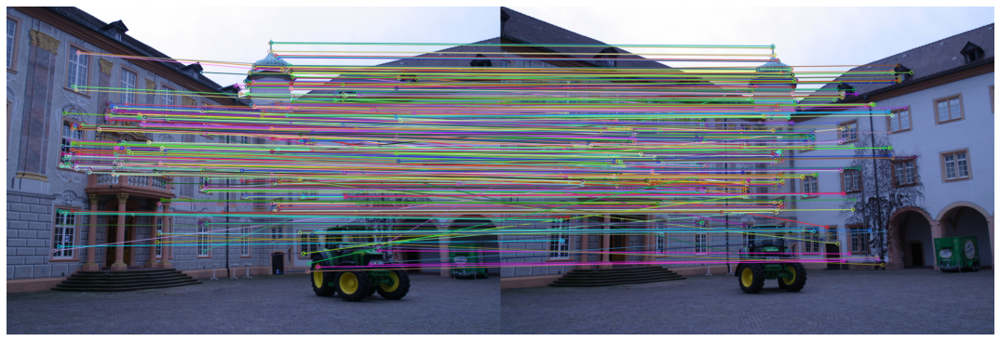

In [11]:
# Robust estimation of the fundamental matrix #
points1 = []
points2 = []
for m in matches:
    points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
    points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])
    
points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

F, indices_inlier_matches = Ransac_fundamental_matrix(points1, points2, 1., 5000)
inlier_matches = itemgetter(*indices_inlier_matches)(matches)
print('Number of found matches by ORB: '+ str(len(points1[0])))
print('The number of inliers found by RANSAC is: '+ str(len(inlier_matches)))

img_12 = cv2.drawMatches(img1c,kp1,img2c,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
fig = plt.figure()
plt.imshow(img_12)
plt.axis('off')
plt.show()

In [12]:
points1

array([[287.   , 511.   , 511.   , ..., 358.318, 498.062, 687.971],
       [366.   , 323.   , 329.   , ..., 404.9  , 429.982, 408.483],
       [  1.   ,   1.   ,   1.   , ...,   1.   ,   1.   ,   1.   ]])

### **3.3 Estimate the Essential Matrix**
<span style='color:Green'> - Compute the [Essential matrix](https://www.cs.cmu.edu/~16385/s17/Slides/12.2_Essential_Matrix.pdf) from the Fundamental matrix </span>

In [67]:
# Camera calibration matrix
K = np.array([[2362.12, 0, 1520.69], [0, 2366.12, 1006.81], [0, 0, 1]])
scale = 0.3;
H = np.array([[scale, 0, 0], [ 0, scale, 0], [0, 0, 1]])
K = H @ K;

def essential_from_fundamental(K, F):
    return K.T @ F @ K

E = essential_from_fundamental(K, F)

In [68]:
#E must be rank 2

U, D, Vt = LA.svd(E)

print('Last eigenvalue = '+str(D[2]))

Last eigenvalue = 5.452711836770399e-18


### **3.4. Estimate the Camera Matrices from the Essential Matrix (Optional)**
<span style='color:Green'> - Estimate the camera projection matrices. Assuming the first Camera has a cannonical matrix you will obtain four possible Camera Matrices for the second camera, two rotations and two translations.</span>

 - Please explain how do you obtain these estimates, not what algorithm or methodology you used to obtain them. i.e., What system of equations are you solving?
 - Why do you obtain 4 solutions? Why not only one?

HINT: Once you estimate the rotations $R$ and translation $T$ of the second camera matrix, you may get as results improper rotations: $|R| = -1$ i.e., $R \in O(3), R \notin SO(3)$. <span style='color:Green'> (Why do you think this happens?) </span> In that case you should make the rotation proper by avoiding the unwanted reflexion (multiply by -1 so $|R| = 1$): e.g.,
  
      if det(R) < 0:  
          R = -R

In [69]:
# camera projection matrix for the first camera

# First camera is reference so external parameters matrix are equal to identity
I = np.eye(3,4)
P1 = K @ I

# # four possible matrices for the second camera
Pc2 = [None, None, None, None];

# helper matrices W and Z
W = np.array([[0, -1,  0],
              [1,  0,  0],
              [0,  0,  1]])
Z = -W

# SVD of E to obtain U
U, D, Vt = np.linalg.svd(E)

# two solutions for translation located in the end column of U (or end row of U^T)
t1 = +U[:, -1]
t2 = -U[:, -1]

# another two solutions for rotation are made with W and its transpose
r1 = U @ W @ Vt
r2 = U @ W.T @ Vt

# suggestion from the above markdown cell
if np.linalg.det(r1) < 0:
    r1 = -r1
if np.linalg.det(r2) < 0:
    r2 = -r2

# system of equations
Pc2[0] = np.hstack((r1, t1[:, np.newaxis]))
Pc2[1] = np.hstack((r1, t2[:, np.newaxis]))
Pc2[2] = np.hstack((r2, t1[:, np.newaxis]))
Pc2[3] = np.hstack((r2, t2[:, np.newaxis]))

# convert from camera coords (distances) to pixels through the intrinsic
#P1 = K @ P1
Pc2[0] = K @ Pc2[0]
Pc2[1] = K @ Pc2[1]
Pc2[2] = K @ Pc2[2]
Pc2[3] = K @ Pc2[3]

Lets visualize the 4 possible Camera positions and orientations, in relation to Camera 1 

(-1.5, 1.5)

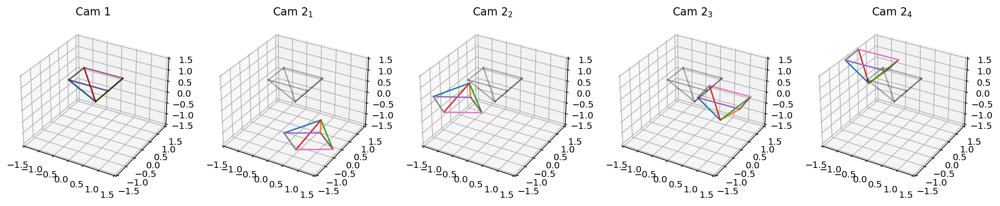

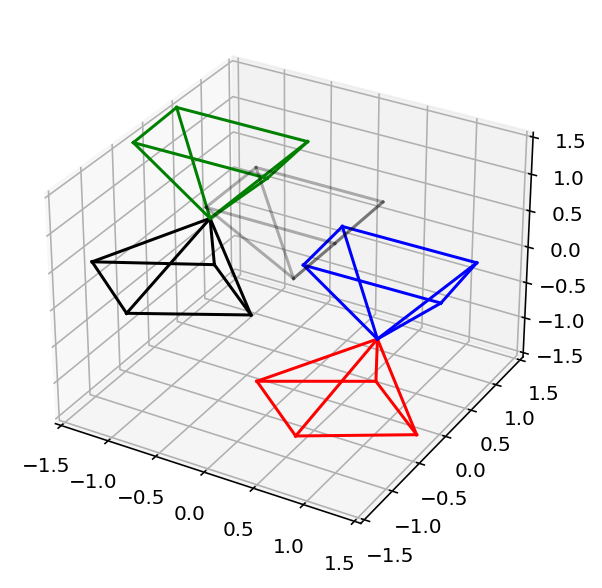

In [70]:
%config InlineBackend.figure_format='retina'

# plot the first camera and the four possible solutions for the second figure:
fig = plt.figure()
axs = [fig.add_subplot(1,5,i+1, projection='3d') for i in range(5)]
titles = ["Cam 1"] + [r"Cam $2_{%s}$" % int(i+1) for i in range(len(Pc2)) ]

low_lim, up_lim = -1.5, 1.5
for ax, title, P in zip(axs, titles, [P1] + Pc2):
    utils.plot_camera(P,w,h, 1, ax=ax)
    utils.plot_camera(P1,w,h, 1, ax=ax, alpha=0.3, color="k") # Show Cam1 for reference
    ax.set_title(title)
    ax.set_xlim(low_lim, up_lim)
    ax.set_ylim(low_lim, up_lim)
    ax.set_zlim(low_lim, up_lim)
    
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1,1,1, projection='3d')
for P, color in zip(Pc2, ['r','k','b','g']):
    utils.plot_camera(P,w,h, 1, ax=ax, color=color)
utils.plot_camera(P1,w,h, 1, ax=ax, alpha=0.3, color="k") # Show Cam1 for reference
ax.set_xlim(low_lim, up_lim)
ax.set_ylim(low_lim, up_lim)
ax.set_zlim(low_lim, up_lim)

<span style='color:Green'> - Triangulate the correspondences and select the "optimal" camera, how do you select it ?</span>
   

0
0
808
14
[[ 7.325e+02  1.065e+02  4.030e+02  5.732e+02]
 [-5.318e+01  7.293e+02  2.459e+02  2.542e+02]
 [ 6.348e-02  8.351e-02  9.945e-01 -1.387e-01]]


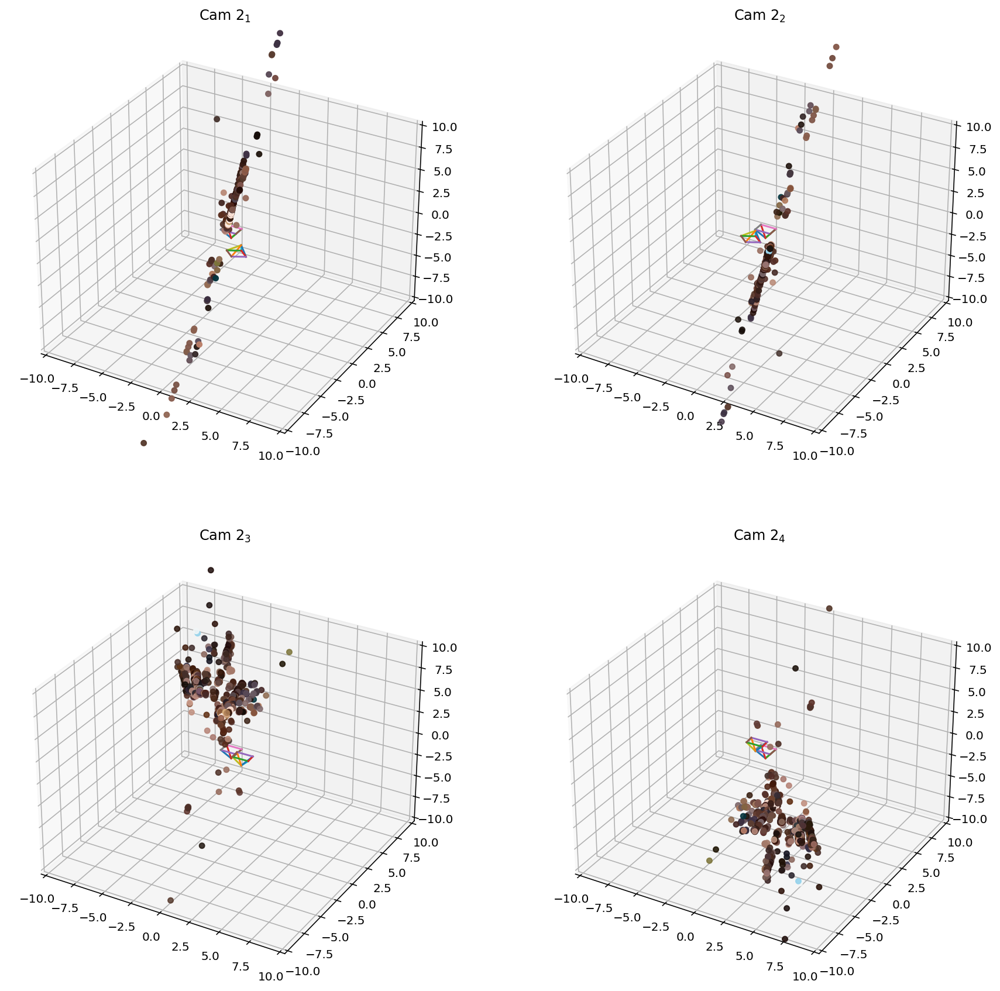

In [71]:
img1 = cv2.imread('Data/0001_s.png',cv2.IMREAD_UNCHANGED)


# Obtain the inlier points projective coordinates for Camera 1 and 2 
x1 = points1[:,indices_inlier_matches]
x2 = points2[:,indices_inlier_matches]

# Prepare figure 
fig = plt.figure(figsize=(15,15))
axs = [fig.add_subplot(2,2,i+1, projection='3d') for i in range(4)]

# Variable for optimal camera
P2_selected = None

low_lim, up_lim = -10, 10

max_metric=0
for i, ax, P2 in zip(range(len(Pc2)), axs, Pc2):
    # Estimate by triangulization the 3D coordinates of the matches
    X_pred = triangulate(x1, x2, P1, P2, [w, h])
    X_eucl = homogeneous2euclidean(X_pred)
    X_pred = X_pred / X_pred[3][np.newaxis]
    
    # Render the 3D point cloud
    x_img = np.transpose(x1[:2]).astype(int)
    rgb_txt = (img1[x_img[:,1], x_img[:,0]])/255
    utils.draw_points(X_eucl.T, color=rgb_txt, ax=ax)
    utils.plot_camera(P1,w,h,1, ax=ax)
    utils.plot_camera(P2,w,h,1, ax=ax)
    ax.set_title(r"Cam $2_{%d}$" % (i+1))
    ax.set_xlim(low_lim, up_lim)
    ax.set_ylim(low_lim, up_lim)
    ax.set_zlim(low_lim, up_lim)

    # Select the best camera using some metric 
    x1_estimate = P1 @ X_pred
    x2_estimate = P2 @ X_pred
    
    # The depth must be higher than zero in both views
    some_metric=0
    for j in range(len(x1_estimate[2])):
        if x1_estimate[2,j]>0 and x2_estimate[2,j]>0:
            some_metric+=1
    print(some_metric)
    if some_metric>max_metric:
        P2_selected = P2
        max_metric=some_metric

# From now own P2 will be the camera you selected
P2 = P2_selected
print(P2)

## WEEK 3

### **3.5 3D Visualization (Optional)**
 We will visualize the 3D points for the selected camera with an interactive plot so that you can see the surfaces reconstructed in 3D

In [72]:
# Estimate by triangulization the 3D coordinates of the matches
X_pred = triangulate(x1, x2, P1, P2, [w, h])
X_eucl = X_pred/X_pred[-1,:]
points3d = X_eucl[:3].T
fig = go.Figure(layout=dict(height=400, width=550))
points3d = X_eucl[:3].T
fig.add_trace(go.Scatter3d(x=points3d[:,0], y=points3d[:,1], z=points3d[:,2],mode='markers',name='3d points',marker=dict(color=rgb_txt, size=2)))
fig.show()


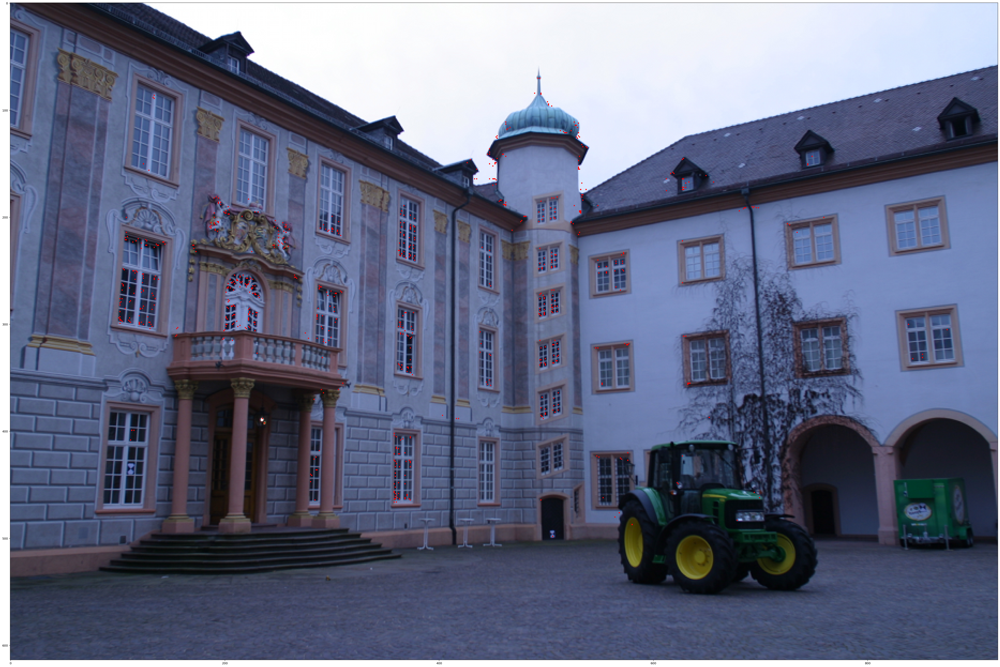

In [73]:
img_with_selected_points = copy.deepcopy(img1c)
img_with_selected_points[x_img[:,1], x_img[:,0]] = [255,0,0]
plt.figure(figsize = (80,40))
plt.imshow(img_with_selected_points)

### **3.6 Reprojection Error (Optional)**

Once you selected a Camera, analyze the error of reprojecting the 3D space back to image coordinates. 

<span style='color:Green'>- Compute the reprojection errors  </span>

<span style='color:Green'>- Plot the histogram of reprojection errors, </span>

<span style='color:Green'>- Plot the mean reprojection error  </span>

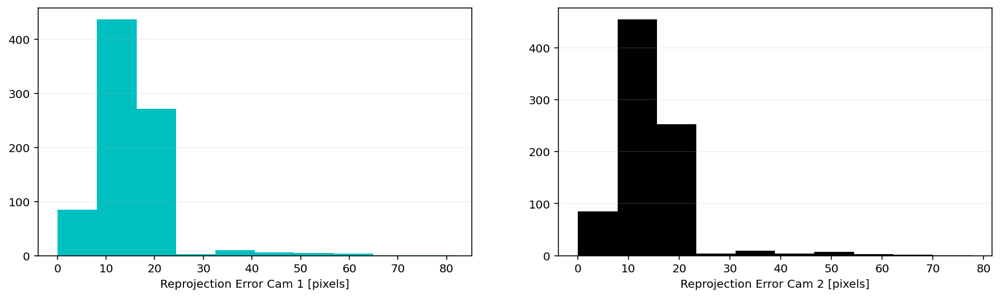

In [74]:
def reprojection_errors(x1, x2, P1, P2, X):
    """
    - x1: array of shape (3, `n_points`), containing matching points in projective coordinates from Camera 1 reference frame 
    - x2: array of shape (3, `n_points`), containing matching points in projective coordinates from Camera 2 reference frame.
    - P1: Camera 1 matrix
    - P2: Camera 2 matrix 
    - X: (4, `n_points`) homogenous coordinates of points in 3D space
    Compute the reprojection error from `X` to each of the camera's projective coordinates
    @return: (cam1_errors, cam2_errors)
    """
    
    '''
    Your implementation here
    
    '''
    #raise NotImplementedError("You must implement this, don't forget")

    X  /=  X[3, :]
    
    x1 /= x1[2, :]
    x2 /= x2[2, :]
    
    x1_P = P1 @ X
    x1_P /= x1_P[2, :]
    
    x2_P = P2 @ X
    x2_P /= x2_P[2, :]
    
    cam1_errors = LA.norm(x1-x1_P, axis=0)
    cam2_errors = LA.norm(x2-x2_P, axis=0)
    
    return cam1_errors, cam2_errors

def plot_error_stats(cam1_errors, cam2_errors):
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,4))
    
    ax1.hist(cam1_errors, color='c')
    ax1.grid(axis='y', alpha=0.2)
    ax1.set_xlabel("Reprojection Error Cam 1 [pixels]")
    ax2.hist(cam2_errors, color='k')
    ax2.grid(axis='y', alpha=0.2)
    ax2.set_xlabel("Reprojection Error Cam 2 [pixels]")


# Get projections with selected Camera 
X_pred = triangulate(x1, x2, P1, P2, [w, h])

cam1_errors, cam2_errors = reprojection_errors(x1, x2, P1, P2, X_pred)

plot_error_stats(cam1_errors, cam2_errors)